In [1]:
import jax
from jax.config import config
config.update("jax_enable_x64", True)

In [2]:
import scanpy as sc
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import moscot
from moscot.problems.time import TemporalProblem
import moscot.plotting as mpl
import pandas as pd
import os

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=200)

import mplscience

mplscience.available_styles()
mplscience.set_style(reset_current=True)
plt.rcParams['legend.scatterpoints'] = 1 

['default', 'despine']


In [3]:
adata = sc.read("/lustre/groups/ml01/workspace/moscot_paper/pancreas/pancreas_multiome_2022_processed.h5ad")

In [4]:
adata.shape

(16918, 242922)

In [5]:
output_dir = "."

In [7]:
tp0 = TemporalProblem.load("/lustre/groups/ml01/workspace/moscot_paper/pancreas/JASPAR_TemporalProblem.pkl")

In [8]:
order_celltypes = ['Ngn3 low', 'Ngn3 high cycling', 'Ngn3 high', 'Eps. progenitors', 'Fev+', 'Fev+ Alpha', 
                   'Fev+ Beta', 'Fev+ Delta', 'Alpha', 'Beta', 'Delta', 'Epsilon']

In [9]:
color_dict = { 'Prlf. Ductal': '#f7b6d2', 'Ductal': '#d62728', 'Imm. Acinar': '#ffbb78', 'Mat. Acinar': '#98df8a',
    'Alpha': '#1f77b4', 'Beta': '#ff7f0e', 'Delta': '#279e68', 'Eps. progenitors': '#aa40fc', 'Epsilon': '#8c564b',
       'Fev+': '#e377c2', 'Fev+ Alpha': '#b5bd61', 'Fev+ Beta': '#aec7e8', 'Fev+ Delta': '#aec7e8', 'Fev+ Delta,0': '#ffbb78', 'Fev+ Delta,1':'#98df8a',
        'Fev+ Delta,2': '#17becf', 'Ngn3 high cycling': '#aec7e8',
        'Ngn3 high,0': '#ff9896', 'Ngn3 high,1':'#f0b98d', 'Ngn3 low': '#c5b0d5'
}

In [10]:
tp0.adata.obs["refinement"] = tp0.adata.obs["refinement"].astype("category")
tp0.adata.uns["refinement_colors"] = [color_dict[ct] for ct in tp0.adata.obs["refinement"].cat.categories]

In [12]:
chromvar_features = [col for col in tp0.adata.obs.columns if col.startswith("MA")]

In [13]:
tp0.pull(14.5, 15.5, data="celltype", subset="Delta", key_added="Delta_pull")

In [14]:
delta_drivers = tp0.compute_feature_correlation(obs_key="Delta_pull", features=chromvar_features)

In [19]:
delta_drivers.index[:20]

Index(['MA1608.1', 'MA0124.2', 'MA0122.3', 'MA0914.1', 'MA0875.1', 'MA1496.1',
       'MA0748.2', 'MA0672.1', 'MA1530.1', 'MA0885.1', 'MA1501.1', 'MA0896.1',
       'MA0076.2', 'MA1497.1', 'MA0028.2', 'MA1500.1', 'MA0148.4', 'MA0506.1',
       'MA1484.1', 'MA0642.1'],
      dtype='object')

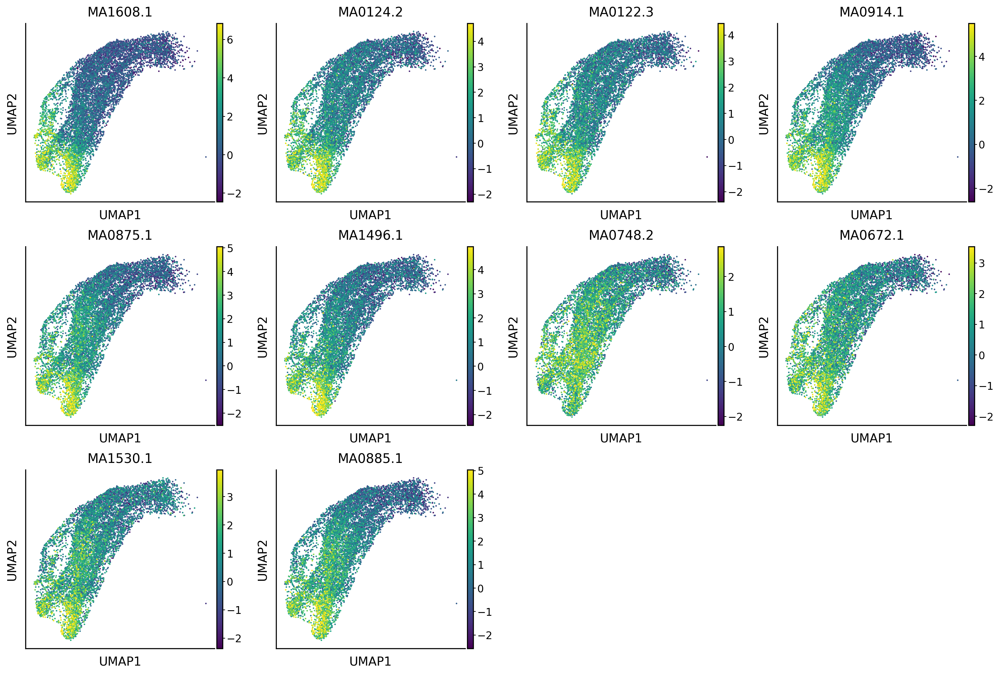

In [16]:
sc.pl.umap(tp0.adata, color=delta_drivers.index[:10], vmin="p01", vmax="p99")

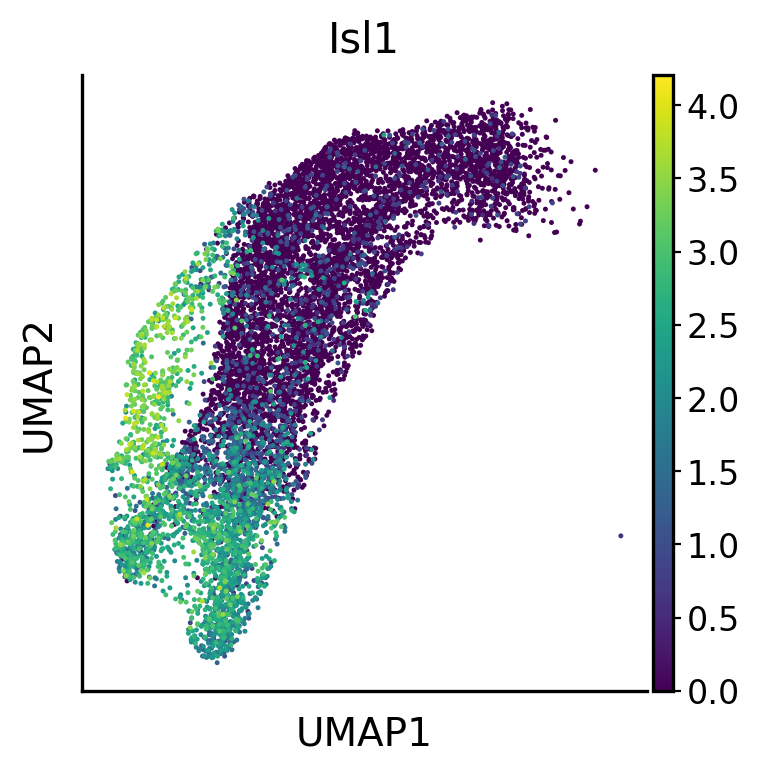

In [17]:
sc.pl.umap(tp0.adata, color="Isl1")

In [20]:
tp0.pull(14.5, 15.5, data="celltype", subset="Beta", key_added="Beta_pull")

In [21]:
beta_drivers = tp0.compute_feature_correlation(obs_key="Beta_pull", features=chromvar_features, annotation={"celltype": ["Beta", "Alpha", "Fev+ Beta"]})

In [22]:
beta_drivers

,Beta_pull_corr,Beta_pull_pval,Beta_pull_qval,Beta_pull_ci_low,Beta_pull_ci_high
MA0659.2,0.376299,6.309111e-66,4.706597e-63,0.336831,0.414446
MA1501.1,0.368545,4.815449e-63,1.796162e-60,0.328825,0.406962
MA0842.2,0.366855,1.993220e-62,4.956473e-60,0.327082,0.405331
MA1521.1,0.360364,4.293033e-60,8.006506e-58,0.320385,0.399061
MA0117.2,0.357111,6.029892e-59,8.996599e-57,0.317031,0.395917
...,...,...,...,...,...
MA0482.2,-0.252962,3.828659e-29,2.856180e-28,-0.294788,-0.210168
MA0847.2,-0.317345,4.873297e-46,1.817740e-44,-0.357415,-0.276109
MA0845.1,-0.323689,5.792146e-48,2.541730e-46,-0.363567,-0.282627
MA0032.2,-0.337376,2.749275e-52,1.577661e-50,-0.376827,-0.296704


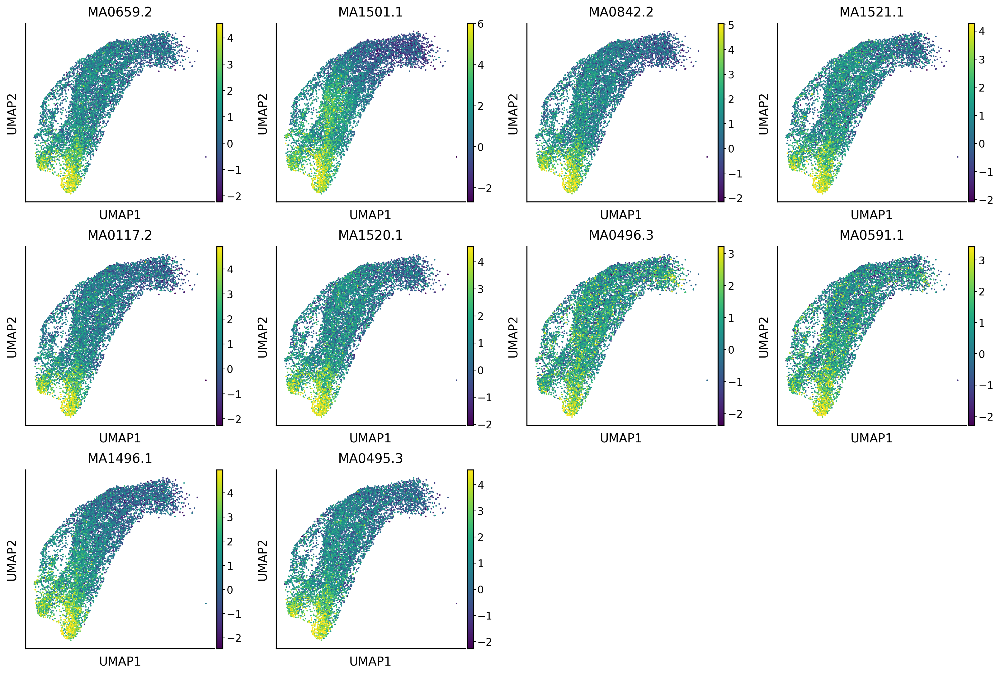

In [23]:
sc.pl.umap(tp0.adata, color=beta_drivers.index[:10], vmin="p01", vmax="p99")

In [25]:
tp0.pull(14.5, 15.5, data="celltype", subset="Alpha", key_added="Alpha_pull")

In [26]:
alpha_drivers = tp0.compute_feature_correlation(obs_key="Alpha_pull", features=chromvar_features)

In [27]:
alpha_drivers

,Alpha_pull_corr,Alpha_pull_pval,Alpha_pull_qval,Alpha_pull_ci_low,Alpha_pull_ci_high
MA0047.3,0.355862,6.431913e-284,4.798207e-281,0.338045,0.373424
MA0148.4,0.342492,2.477091e-261,9.239548e-259,0.324489,0.360247
MA1608.1,0.339871,4.838473e-257,1.203167e-254,0.321833,0.357663
MA0042.2,0.338966,1.433305e-255,1.336557e-253,0.320915,0.356770
MA0033.2,0.338966,1.433305e-255,1.336557e-253,0.320915,0.356770
...,...,...,...,...,...
MA0039.4,-0.263312,4.493087e-150,9.059036e-149,-0.282062,-0.244362
MA0756.1,-0.263776,1.272881e-150,2.637691e-149,-0.282520,-0.244830
MA1643.1,-0.264896,5.982047e-152,1.288106e-150,-0.283628,-0.245962
MA0757.1,-0.288683,9.213167e-182,2.545564e-180,-0.307141,-0.270008


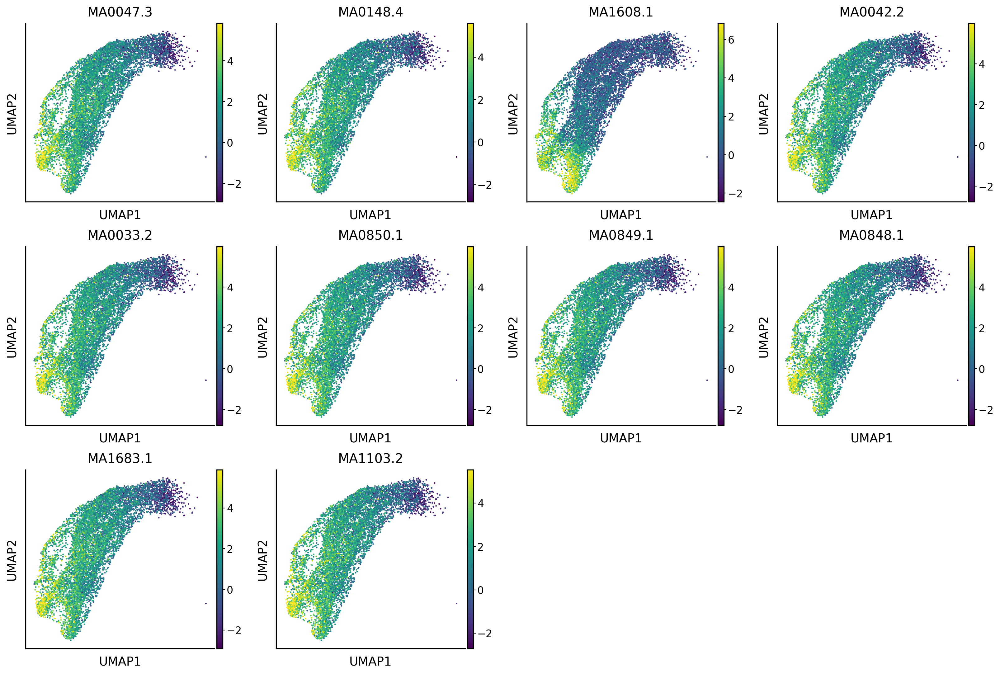

In [29]:
sc.pl.umap(tp0.adata, color=alpha_drivers.index[:10], vmin="p01", vmax="p99")

In [30]:
tp0.pull(14.5, 15.5, data="celltype", subset="Epsilon", key_added="Epsilon_pull")

In [31]:
eps_drivers = tp0.compute_feature_correlation(obs_key="Epsilon_pull", features=chromvar_features)

In [32]:
eps_drivers

,Epsilon_pull_corr,Epsilon_pull_pval,Epsilon_pull_qval,Epsilon_pull_ci_low,Epsilon_pull_ci_high
MA0845.1,0.167606,3.050655e-60,2.275789e-57,0.147854,0.187224
MA0847.2,0.166913,9.460076e-60,3.528608e-57,0.147157,0.186536
MA0846.1,0.162924,5.772138e-57,1.435338e-54,0.143143,0.182575
MA0032.2,0.160967,1.263284e-55,2.356025e-53,0.141174,0.180632
MA1487.1,0.153816,7.131465e-51,1.064015e-48,0.133980,0.173529
...,...,...,...,...,...
MA0621.1,-0.100364,1.961836e-22,4.573530e-21,-0.120373,-0.080273
MA0046.2,-0.101629,5.764556e-23,1.387212e-21,-0.121632,-0.081543
MA0153.2,-0.109733,1.559167e-26,3.877129e-25,-0.129698,-0.089679
MA0598.3,-0.110487,7.028039e-27,1.807902e-25,-0.130449,-0.090436


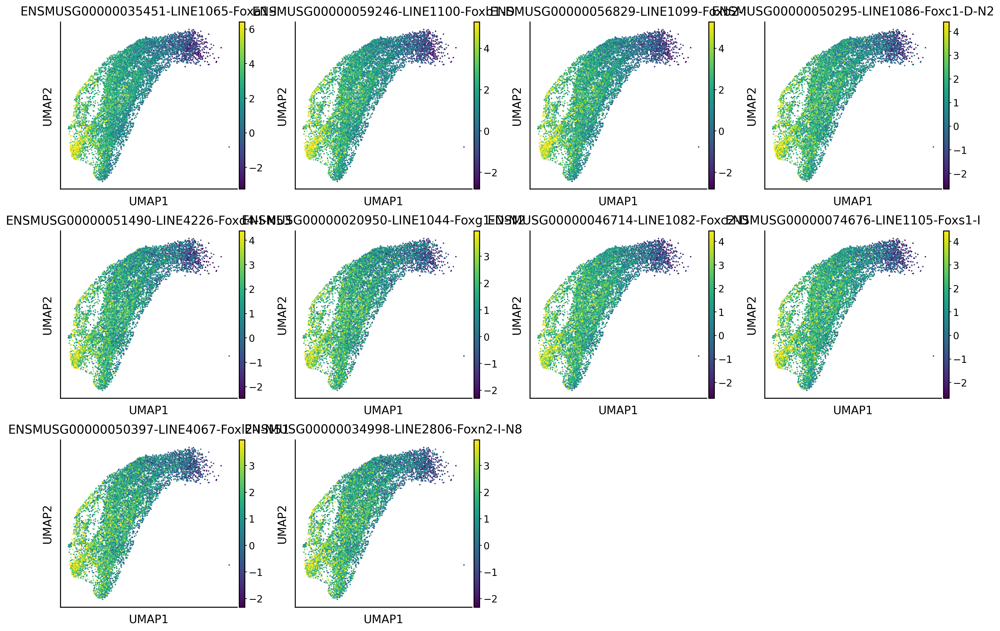

In [25]:
sc.pl.umap(tp0.adata, color=eps_drivers.index[:10], vmin="p01", vmax="p99")

In [33]:
eps_drivers = tp0.compute_feature_correlation(obs_key="Epsilon_pull", features=chromvar_features, annotation={"celltype": ["Epsilon", "Alpha", "Delta", "Ngn3 high", "Fev+ Delta"]})

In [34]:
eps_drivers

,Epsilon_pull_corr,Epsilon_pull_pval,Epsilon_pull_qval,Epsilon_pull_ci_low,Epsilon_pull_ci_high
MA1608.1,0.233216,1.482702e-61,1.106096e-58,0.206449,0.259635
MA0845.1,0.200164,2.219276e-45,8.277900e-43,0.173016,0.227008
MA0032.2,0.185497,4.492988e-39,1.117256e-36,0.158200,0.212510
MA0847.2,0.184458,1.200712e-38,2.239328e-36,0.157151,0.211482
MA1607.1,0.176253,2.291592e-35,2.849212e-33,0.148869,0.203367
...,...,...,...,...,...
MA1642.1,-0.148470,1.965089e-25,4.581114e-24,-0.175858,-0.120853
MA1472.1,-0.148480,1.951501e-25,4.581114e-24,-0.175867,-0.120863
MA1467.1,-0.155150,1.171379e-27,3.236477e-26,-0.182475,-0.127585
MA0046.2,-0.159380,4.042058e-29,2.010250e-27,-0.186665,-0.131850


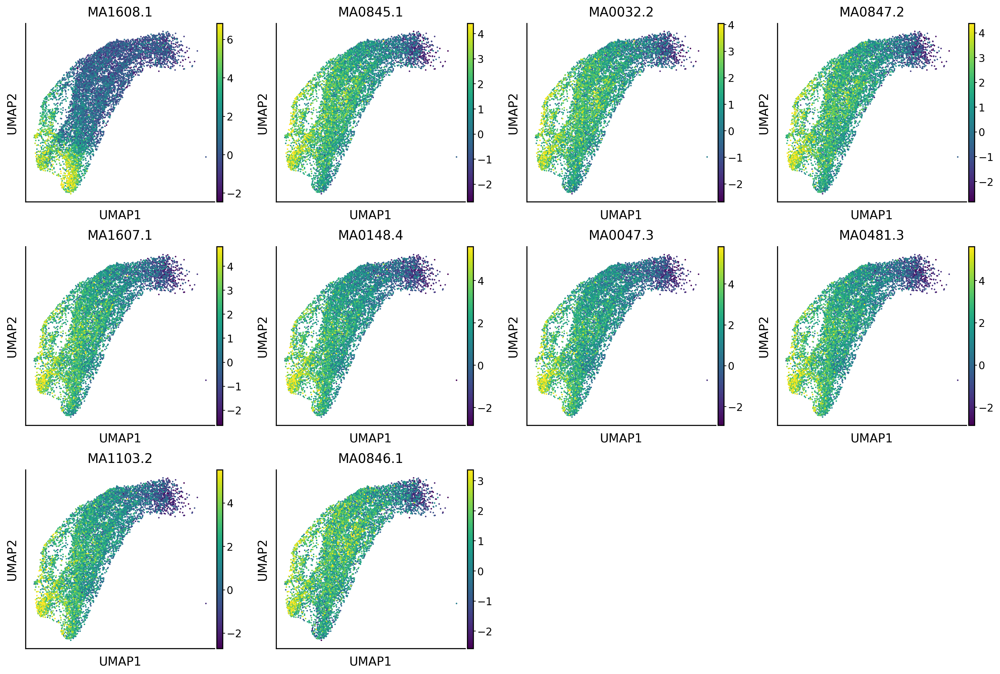

In [36]:
sc.pl.umap(tp0.adata, color=eps_drivers.index[:10], vmin="p01", vmax="p99")

In [37]:
tp0.pull(14.5, 15.5, data="celltype", subset=["Epsilon", "Delta", "Fev+ Delta", "Eps. progenitors"], key_added="eps-delta")

In [38]:
eps_delta_drivers = tp0.compute_feature_correlation(obs_key="eps-delta", features=chromvar_features, annotation={"celltype": ["Ngn3 high", "Eps. progenitors"]})

In [39]:
eps_delta_drivers

,eps-delta_corr,eps-delta_pval,eps-delta_qval,eps-delta_ci_low,eps-delta_ci_high
MA1608.1,0.225873,5.172973e-49,3.859038e-46,0.196628,0.254716
MA1487.1,0.212747,1.633433e-43,6.092705e-41,0.183337,0.241776
MA0148.4,0.211860,3.725036e-43,9.262923e-41,0.182440,0.240902
MA0848.1,0.202883,1.271734e-39,1.185892e-37,0.173355,0.232046
MA0033.2,0.202883,1.271734e-39,1.185892e-37,0.173355,0.232046
...,...,...,...,...,...
MA0643.1,-0.101714,6.375240e-11,1.358837e-09,-0.131907,-0.071332
MA0592.3,-0.103397,3.061103e-11,6.919948e-10,-0.133578,-0.073025
MA0698.1,-0.113964,2.332539e-13,5.613143e-12,-0.144065,-0.083652
MA0505.1,-0.123302,2.112048e-15,5.627099e-14,-0.153327,-0.093049


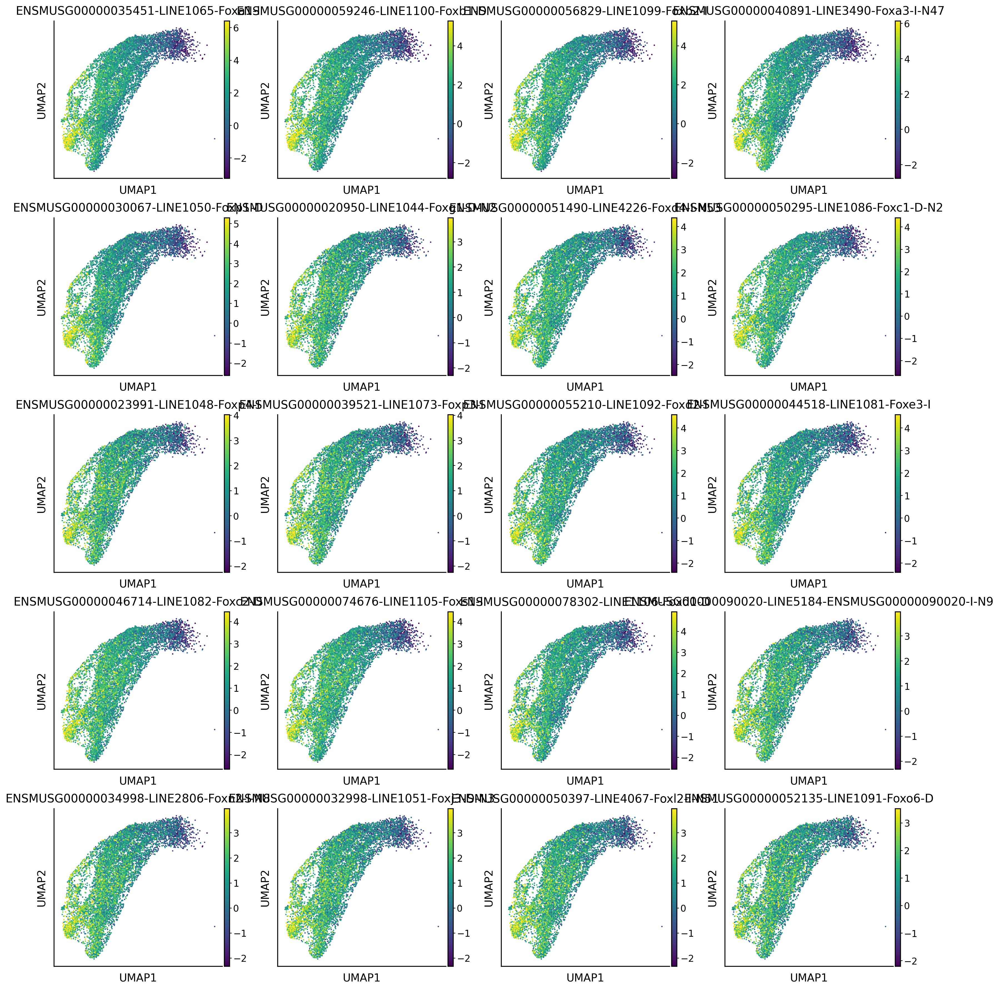

In [42]:
sc.pl.umap(tp0.adata, color=eps_drivers.index[:20], vmin="p01", vmax="p99")

In [54]:
tp0.pull(14.5, 15.5, data="refinement", subset=["Ngn3 high,0"], key_added="eps_prog")

In [55]:
eps_prog = tp0.compute_feature_correlation(obs_key="eps_prog", features=chromvar_features, annotation={"celltype": ["Ngn3 high", "Eps. progenitors"]})

In [56]:
eps_prog

,eps_prog_corr,eps_prog_pval,eps_prog_qval,eps_prog_ci_low,eps_prog_ci_high
MA1643.1,0.495999,9.212193e-266,6.872296e-263,0.472569,0.518729
MA1528.1,0.485130,4.529749e-252,1.689596e-249,0.461376,0.508188
MA1527.1,0.478629,3.824141e-244,9.509363e-242,0.454686,0.501881
MA0505.1,0.437676,2.212832e-198,3.301546e-196,0.412599,0.462090
MA1540.1,0.437181,7.184802e-198,8.933104e-196,0.412091,0.461609
...,...,...,...,...,...
MA0853.1,-0.366464,1.082593e-133,4.486746e-132,-0.392664,-0.339669
MA0703.2,-0.366798,5.886766e-134,2.583251e-132,-0.392990,-0.340011
MA0510.2,-0.375568,5.018237e-141,2.339753e-139,-0.401556,-0.348975
MA0798.2,-0.432905,1.728976e-193,1.842594e-191,-0.457448,-0.407703


In [48]:
sc.pl.umap(adata, color="Foxb2")

KeyError: 'Could not find key Foxb2 in .var_names or .obs.columns.'